In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import  OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, ConfusionMatrixDisplay, RocCurveDisplay
import matplotlib.pyplot as plt
import warnings

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

In [2]:
# Import dataset
print("Loading dataset...")
df = pd.read_csv('conversion_data_train.csv')
print("...Done.")
print()

Loading dataset...
...Done.



In [3]:
# Basic stats
print("Number of rows : {}".format(df.shape[0]))
print()

print("Display of df: ")
display(df.head())
print()

print("Basics statistics: ")
data_desc = df.describe(include='all')
display(data_desc)
print()

print("Percentage of missing values: ")
display(round(100*df.isnull().sum()/df.shape[0], 2))

Number of rows : 284580

Display of df: 


,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0



Basics statistics: 


,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000



Percentage of missing values: 


country                0.0
age                    0.0
new_user               0.0
source                 0.0
total_pages_visited    0.0
converted              0.0
dtype: float64

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284580 entries, 0 to 284579
Data columns (total 6 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   country              284580 non-null  object
 1   age                  284580 non-null  int64 
 2   new_user             284580 non-null  int64 
 3   source               284580 non-null  object
 4   total_pages_visited  284580 non-null  int64 
 5   converted            284580 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 13.0+ MB


In [5]:
df.head()

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


In [6]:
# EDA visualization
fig = px.histogram(df, x='country', y='converted', title='Converted user / Country', color='country')
# fig.update_xaxes(type='date')
fig.show()

In [7]:
# EDA visualization
fig = px.histogram(df, x='age', y='converted', title='Converted user / age', color='country')
# fig.update_xaxes(type='date')
fig.show()

In [8]:
# EDA visualization
fig = px.histogram(df, x='source', y='converted', title='Converted user / source', color='country')
# fig.update_xaxes(type='date')
fig.show()

In [9]:
# EDA visualization
fig = px.histogram(df, x='total_pages_visited', y='converted', title='Converted user / total_pages_visited', color='country')
# fig.update_xaxes(type='date')
fig.show()

In [10]:
# EDA visualization
fig = px.pie(df, values='new_user', names='converted', title='Converted users / New user')
# fig.update_xaxes(type='date')
fig.show()

In [11]:
# Remove age outlier
mask = (df['age'] < 100) & (df['age'] >= 17)
df = df[mask]

df.head()

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


In [12]:
# Separate target variable Y from features X
print("Separating labels from features...")
target_variable = "converted"

X = df.drop(target_variable, axis = 1)
Y = df.loc[:,target_variable]

print("...Done.")
print()

print('Y : ')
print(Y.head())
print()
print('X :')
print(X.head())

Separating labels from features...
...Done.

Y : 
0    0
1    0
2    1
3    0
4    0
Name: converted, dtype: int64

X :
   country  age  new_user  source  total_pages_visited
0    China   22         1  Direct                    2
1       UK   21         1     Ads                    3
2  Germany   20         0     Seo                   14
3       US   23         1     Seo                    3
4       US   28         1  Direct                    3


In [13]:
# Automatically detect names of numeric/categorical columns
numeric_features = ['age', 'total_pages_visited', 'new_user']
categorical_features = ['country', 'source']

print(numeric_features)
print(categorical_features)

['age', 'total_pages_visited', 'new_user']
['country', 'source']


In [14]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
# WARNING : don't forget stratify=Y for classification problems
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0, stratify = Y)
print("...Done.")
print()

Dividing into train and test sets...


...Done.



In [15]:
# Create pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

# Create pipeline for categorical features
categorical_transformer = OneHotEncoder(drop='first')

In [16]:
# Use ColumnTransformer to make a preprocessor object that describes all the treatments to be done
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

In [17]:
# Preprocessings on train set
print("Performing preprocessings on train set...")
print(X_train.head())
X_train = preprocessor.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()
# Label encoding
print("Encoding labels...")
print(Y_train.head())
encoder = LabelEncoder()
Y_train = encoder.fit_transform(Y_train)
print("...Done")
print(Y_train[0:5])

# Preprocessings on test set
print("Performing preprocessings on test set...")
print(X_test.head()) 
X_test = preprocessor.transform(X_test) # Don't fit again !! The test set is used for validating decisions
# we made based on the training set, therefore we can only apply transformations that were parametered using the training set.
# Otherwise this creates what is called a leak from the test set which will introduce a bias in all your results.
print('...Done.')
print(X_test[0:5,:]) # MUST use this syntax because X_test is a numpy array and not a pandas DataFrame anymore
print()
# Label encoding
print("Encoding labels...")
print(Y_test[0:5])
Y_test = encoder.transform(Y_test)
print("...Done")
print(Y_test[0:5])

Performing preprocessings on train set...
        country  age  new_user  source  total_pages_visited
70238        US   23         0  Direct                    5
11738        US   26         1     Ads                    4
51223   Germany   39         1     Ads                    2
251695       US   39         1     Seo                    8
30005        US   44         1     Seo                    2


...Done.
[[-0.91614386  0.0376251  -1.47777425  0.          0.          1.
   1.          0.        ]
 [-0.55333446 -0.2616379   0.67669334  0.          0.          1.
   0.          0.        ]
 [ 1.01883962 -0.86016391  0.67669334  1.          0.          0.
   0.          0.        ]
 [ 1.01883962  0.9354141   0.67669334  0.          0.          1.
   0.          1.        ]
 [ 1.62352196 -0.86016391  0.67669334  0.          0.          1.
   0.          1.        ]]

Encoding labels...
70238     0
11738     0
51223     0
251695    0
30005     0
Name: converted, dtype: int64
...Done
[0 0 0 0 0]
Performing preprocessings on test set...
       country  age  new_user  source  total_pages_visited
138303      UK   34         1     Ads                    1
133130      UK   32         0     Ads                    5
245758      US   44         1     Ads                    1
185267      US   35         1  Direct                    1
177637      US   29         1  Direct                    3


In [18]:
# Train model
print("Train model...")
classifier = LogisticRegression()
classifier.fit(X_train, Y_train)
print("...Done.")

Train model...
...Done.


In [19]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on training set...")
Y_train_proba = classifier.predict_proba(X_train)
print("...Done.")
print(Y_train_proba)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on training set...
...Done.
[[9.94625285e-01 5.37471467e-03]
 [9.99544301e-01 4.55699308e-04]
 [9.99937580e-01 6.24203582e-05]
 ...
 [9.99822059e-01 1.77941071e-04]
 [8.71474712e-01 1.28525288e-01]
 [9.95684985e-01 4.31501514e-03]]



In [20]:
# Predictions on test set
print("Predictions on test set...")
Y_test_pred = classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on test set...")
Y_test_proba = classifier.predict_proba(X_test)
print("...Done.")
print(Y_test_proba)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on test set...
...Done.
[[9.99963596e-01 3.64041856e-05]
 [9.95149587e-01 4.85041266e-03]
 [9.99987687e-01 1.23130344e-05]
 ...
 [9.99759965e-01 2.40034694e-04]
 [9.97404006e-01 2.59599359e-03]
 [9.99586621e-01 4.13378866e-04]]



In [21]:
# Print scores
print("accuracy on training set : ", accuracy_score(Y_train, Y_train_pred))
print("accuracy on test set : ", accuracy_score(Y_test, Y_test_pred))
print()

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))
print()

accuracy on training set :  0.9862427633948573
accuracy on test set :  0.9862077447466442

f1-score on training set :  0.7636583157259282
f1-score on test set :  0.7646176911544227



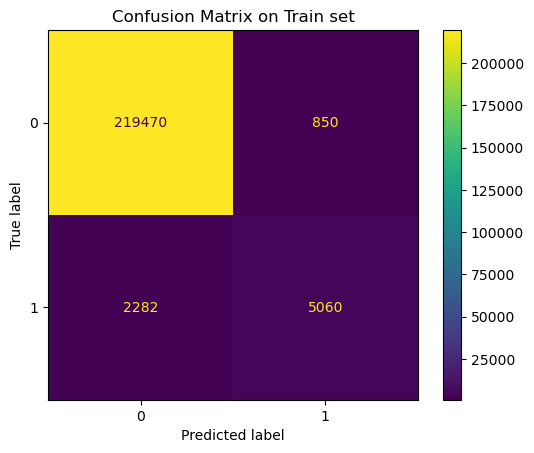

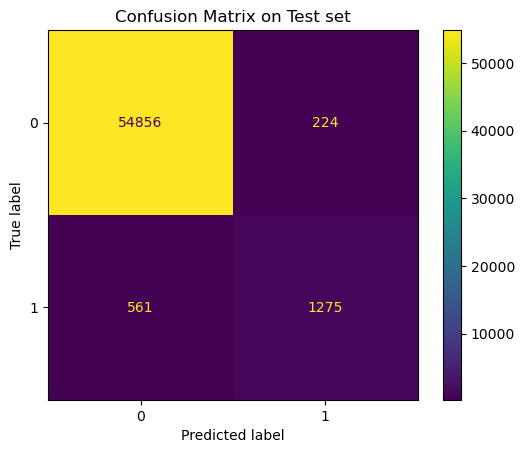

In [22]:
# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()